In [1]:
%pip install Lifetimes
%pip install lifelines
%pip install squarify
%pip install plotly
%pip install pyecharts
%pip install pandas
%pip install seaborn
%pip install pandas_profiling
%pip install openpyxl
%pip install sklearn
%pip install scikit-learn


Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import plotly.graph_objects as go
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from lifelines import CoxPHFitter
from pandas_profiling import ProfileReport
import datetime as dt
import plotly.figure_factory as ff
import plotly.express as px
from lifetimes import BetaGeoFitter
from lifetimes import GammaGammaFitter
from lifetimes.plotting import *
from lifetimes.utils import *
from lifetimes.utils import summary_data_from_transaction_data
from lifetimes.plotting import plot_probability_alive_matrix
from lifetimes.plotting import plot_frequency_recency_matrix
from lifetimes.plotting import plot_period_transactions
from lifetimes.utils import calibration_and_holdout_data
from pyecharts.charts import Pie
from pyecharts import options as opts
import squarify
import sklearn

# Data Preperation

In [3]:
#original dataset
data = pd.read_excel("Dataset.xlsx")

In [5]:
#understanding the time min max of the original data
data['InvoiceDate'].agg(['min', 'max'])

min   2009-12-01 07:45:00
max   2010-12-09 20:01:00
Name: InvoiceDate, dtype: datetime64[ns]

In [6]:
#first 3 rows for better understanding
data.head(3)

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.95,13085.0,United Kingdom
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,13085.0,United Kingdom


In [7]:
#excluding the duplicates, ensuring qunatities are above zero, deriving the total purchase
fd = data.drop_duplicates()
fd = fd [['Customer ID','Description','InvoiceDate','Invoice','Quantity','Price', 'Country']]
fd = fd[(fd['Quantity']>0)]
fd['TotalPurchase'] = fd['Quantity'] * fd['Price']

In [8]:
# first 3 rows of the cleaned data
fd.head(3)

,Customer ID,Description,InvoiceDate,Invoice,Quantity,Price,Country,TotalPurchase
0,13085.0,15CM CHRISTMAS GLASS BALL 20 LIGHTS,2009-12-01 07:45:00,489434,12,6.95,United Kingdom,83.4
1,13085.0,PINK CHERRY LIGHTS,2009-12-01 07:45:00,489434,12,6.75,United Kingdom,81.0
2,13085.0,WHITE CHERRY LIGHTS,2009-12-01 07:45:00,489434,12,6.75,United Kingdom,81.0


In [9]:
# total qunatity of the products and the unique customers
Total_Purchase = fd['Quantity'].sum()
Total_Customers = len(fd['Customer ID'].unique())

In [10]:
Total_Purchase

5992601

In [11]:
Total_Customers

4315

In [12]:
#grouping data by unique products and determining their TotalPurchase
#for the y axis of the plot we derive the percents of the products described above
df_plot_bar = fd.groupby('Description').agg({'TotalPurchase':'sum'}).sort_values(by = 'TotalPurchase', ascending=False).reset_index().head(5)
df_plot_bar['Percent'] = round((df_plot_bar['TotalPurchase'] / df_plot_bar['TotalPurchase'].sum()) * 100,2)
fir_plotbar = px.bar(df_plot_bar, y='Percent', x='Description', title='Top selling products', 
text='Percent', color='Percent')
fir_plotbar.update_traces(texttemplate='%{text:.2s}', textposition='inside')
fir_plotbar.update_layout({
'plot_bgcolor': 'rgba(0, 0, 0, 0)',
'paper_bgcolor': 'rgba(1, 0, 0, 0)',
})
fir_plotbar.update_layout(uniformtext_minsize=8, uniformtext_mode='hide',showlegend=False)                
fir_plotbar.show()            

In [13]:
#this plot basicaly shows the purchase trend among countries. Its data is combination of groupby and agg as shown bellow.
df_plot = fd.groupby(['Country','Description','Price','Quantity', 'InvoiceDate']).agg({'TotalPurchase': 'sum'},{'Quantity':'sum'}).reset_index()
fig_miricle = px.scatter(df_plot[:25000], x="Price", y="Quantity", color = 'Country', 
        size='TotalPurchase',  size_max=20, log_y= True, log_x= True, title= "PURCHASE TREND ACROSS COUNTRIES")
fig_miricle.update_layout({
'plot_bgcolor': 'rgba(0, 0, 0, 0)',
'paper_bgcolor': 'rgba(1, 0, 0, 0)',
})

fig_miricle.show()

In [14]:
# from dash import Dash, dcc, html, Input, Output
# import plotly.express as px

# import pandas as pd


# ggg = Dash(__name__)

# ggg.layout = html.Div([
#     dcc.Graph(id='graph-with-slider'),
#     dcc.Slider(
#         df_plot['InvoiceDate'].min(),
#         df_plot['InvoiceDate'].max(),
#         step=None,
#         value=df_plot['InvoiceDate'].min(),
#         marks={str(year): str(year) for year in df_plot['InvoiceDate'].unique()},
#         id='year-slider'
#     )
# ])


# @ggg.callback(
#     Output('graph-with-slider', 'figure'),
#     Input('year-slider', 'value'))

# def update_figure(selected_year):
#     filtered_df = df_plot[df_plot['Country'] == selected_year]


    
#     fig_miricle = px.scatter(filtered_df[:25000], x="Price", y="Quantity", color = 'Country', 
#                              size='TotalPurchase',  size_max=20, log_y= True, log_x= True, 
#                              title= "PURCHASE TREND ACROSS COUNTRIES")



#     fig_miricle.update_layout(transition_duration=500)

#     return fig_miricle


# if __name__ == '__main__':
#     ggg.run_server(debug=True, port = 7890)


In [15]:
#in the plot below you can see the time series based on the quantity 
fig = go.Figure([go.Scatter(x=fd['InvoiceDate'], y=fd['Quantity'])])
 
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                    step="day",
                    stepmode="backward"),
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
    )
)
 
fig.show()

In [16]:
#here we move to the RFM for a further analysis of the data
new = summary_data_from_transaction_data(fd, 'Customer ID', 'InvoiceDate', monetary_value_col='TotalPurchase', observation_period_end='2011-12-9')
new.head()

,frequency,recency,T,monetary_value
Customer ID,,,,
12346.0,6.0,196.0,725.0,47.143333
12347.0,1.0,37.0,404.0,711.790000
12348.0,0.0,0.0,438.0,0.000000
12349.0,2.0,182.0,589.0,801.310000
12351.0,0.0,0.0,375.0,0.000000


In [17]:
# the plot below shows the percents of the frequencys of the RFM, which was defined above
new['percent'] = round((new['frequency'] / new['frequency'].sum()) * 100,2)
fir_plot = px.bar(new, y=new['percent'], x=new['frequency'], title='Frequency BarChart', color='percent')
fir_plot.show()

In [18]:
#we are grouping the cleansed data fd by the Customer ID and Country for defining num_days, num_transactions, num_units and spent_money
fdg = fd.groupby(['Customer ID','Country']).agg({'InvoiceDate': lambda date: (date.max() - date.min()).days,
                                                 'Quantity': lambda quant: quant.sum(),
                                                 'Invoice': lambda num: len(num),
                                                 'TotalPurchase': lambda price: price.sum()    })
fdg.columns=['num_days','num_transactions','num_units','spent_money']
fdg['avg_order_value'] = fdg['spent_money']/fdg['num_transactions']
purchase_frequency = sum(fdg['num_transactions'])/4319

In [19]:
#Here we calculate the repeat_rate and the churn_rate
repeat_rate = round(fdg[fdg.num_transactions > 1].shape[0]/fdg.shape[0],2)
churn_rate = round(1-repeat_rate,2)

In [20]:
fdg.reset_index()

,Customer ID,Country,num_days,num_transactions,num_units,spent_money,avg_order_value
0,12346.0,United Kingdom,196,70,33,372.86,5.326571
1,12347.0,Iceland,37,828,71,1323.32,1.598213
2,12348.0,Finland,0,373,20,222.16,0.595603
3,12349.0,Italy,181,993,102,2671.14,2.689970
4,12351.0,Unspecified,0,261,21,300.93,1.152989
...,...,...,...,...,...,...,...
4314,18283.0,United Kingdom,275,322,217,619.37,1.923509
4315,18284.0,United Kingdom,0,494,28,461.68,0.934575
4316,18285.0,United Kingdom,0,145,12,427.00,2.944828
4317,18286.0,United Kingdom,247,608,67,1296.43,2.132286


In [21]:
#here we do further calculations for better understading of the customers, we take an abstract profit margin 0.05
# we calcualte the CLV
fdg['profit_margin'] = fdg['spent_money']*0.05
fdg['CLV'] = (fdg['avg_order_value']*purchase_frequency)/churn_rate
fdg.reset_index(inplace = True)
fdg['spent_money', 'avg_order_value','profit_margin'] = fdg.spent_money.apply(lambda x : "{:,}".format(x))
data.dropna(inplace=True)
data["InvoiceDate"] = pd.to_datetime(data["InvoiceDate"])
data["InvoiceDate"].max()
today_date = dt.datetime(2011, 12, 11)
data["TotalPrice"] = data["Price"] * data["Quantity"]

In [22]:
#important statistics
purchase_frequency,repeat_rate,churn_rate

(1278.1773558694142, 0.99, 0.01)

In [23]:
fdg.head(3)

,Customer ID,Country,num_days,num_transactions,num_units,spent_money,avg_order_value,profit_margin,CLV,"(spent_money, avg_order_value, profit_margin)"
0,12346.0,United Kingdom,196,70,33,372.86,5.326571,18.643,680830.298442,372.86
1,12347.0,Iceland,37,828,71,1323.32,1.598213,66.166,204279.910455,"1,323.32"
2,12348.0,Finland,0,373,20,222.16,0.595603,11.108,76128.654525,222.16


In [24]:
#for seperating the customers based on their RFM scores we define a data called rfm
rfm = data.groupby("Customer ID").agg({"InvoiceDate": lambda InvıiceDate: (today_date- InvıiceDate.max()).days,
                                       "Invoice": lambda Invoice: Invoice.nunique(),
                                       "TotalPrice": lambda TotalPrice: TotalPrice.sum()})
rfm.columns = ["recency","frequency","monetary"]
#excluding below zero monetary values
rfm = rfm[rfm["monetary"] > 0]
rfm.describe().T

,count,mean,std,min,25%,50%,75%,max
recency,4282.0,453.560953,95.734145,3.660000e+02,382.0000,415.00,495.0000,739.00
frequency,4282.0,5.455395,10.148765,1.000000e+00,1.0000,3.00,6.0000,270.00
monetary,4282.0,1971.709950,8596.562848,1.776357e-15,303.6925,686.65,1683.9625,341776.73


In [25]:
rfm["recency_score"] = pd.qcut(rfm['recency'], 5, labels=[5, 4, 3, 2, 1])
rfm["frequency_score"] = pd.qcut(rfm["frequency"].rank(method="first"), 5, labels=[1, 2, 3, 4, 5])
rfm["monetary_score"] = pd.qcut(rfm["monetary"], 5, labels=[1, 2, 3, 4, 5])
rfm["RFM_SCORE"] = (rfm["recency_score"].astype(str) + rfm["frequency_score"].astype(str))

In [26]:
seg_map = {
    r'[1-2][1-2]': 'HIBERNATING',
    r'[1-2][3-4]': 'AT RISK',
    r'[1-2]5': 'CANT LOSE',
    r'3[1-2]': 'ABOUT TO SLEEP',
    r'33': 'NEED ATTENTION',
    r'[3-4][4-5]': 'LOYAL CUSTOMER',
    r'41': 'PROMISING',
    r'51': 'NEW CUSTOMERS',
    r'[4-5][2-3]': 'POTENTIAL LOYALIST',
    r'5[4-5]': 'CHAMPIONS'
}
rfm['segment'] = rfm['RFM_SCORE'].replace(seg_map, regex=True)
rfm.head(10)

,recency,frequency,monetary,recency_score,frequency_score,monetary_score,RFM_SCORE,segment
Customer ID,,,,,,,,
12347.0,368,2,1323.32,5,2,4,52,POTENTIAL LOYALIST
12348.0,439,1,222.16,2,1,1,21,HIBERNATING
12349.0,408,4,2646.99,3,3,5,33,NEED ATTENTION
12351.0,376,1,300.93,5,1,2,51,NEW CUSTOMERS
12352.0,376,2,343.80,5,2,2,52,POTENTIAL LOYALIST
12353.0,409,1,317.76,3,1,2,31,ABOUT TO SLEEP
12355.0,568,1,488.21,1,1,2,11,HIBERNATING
12356.0,381,3,3562.25,4,3,5,43,POTENTIAL LOYALIST
12357.0,389,2,12079.99,4,2,5,42,POTENTIAL LOYALIST


In [27]:
rfm[["segment", "recency", "frequency", "monetary"]].groupby("segment").agg(["mean", "count"])

recency        frequency           monetary      
                          mean count       mean count         mean count
segment                                                                 
ABOUT TO SLEEP      416.171171   333   1.360360   333   461.130330   333
AT RISK             514.787829   608   3.677632   608  1009.869278   608
CANT LOSE           487.717391    92  11.043478    92  3511.697174    92
CHAMPIONS           370.988710   620  16.003226   620  6801.576440   620
HIBERNATING         572.638806  1005   1.232836  1005   380.881676  1005
LOYAL CUSTOMER      399.157552   768   8.548177   768  2779.925514   768
NEED ATTENTION      415.170213   188   2.909574   188   985.763245   188
NEW CUSTOMERS       372.702128    47   1.000000    47   352.439787    47
POTENTIAL LOYALIST  382.389414   529   2.349716   529   727.982762   529
PROMISING           388.923913    92   1.000000    92   331.430761    92

In [28]:
sgm= rfm["segment"].value_counts()
c = sgm.index.tolist()
d = sgm.tolist()
color_series = ['#5b9aa0','#667292','#8d9db6','#daebe8','#d6d4e0',
 '#e4d1d1','#b0aac0','#f9d5e5','#b9b0b0','#622569']
rosechart = Pie(init_opts=opts.InitOpts(width='1350px', height='750px'))
rosechart.set_colors(color_series)
rosechart.add("", [list(z) for z in zip(c, d)],
        radius=["20%", "95%"], 
        center=["30%", "60%"],
        rosetype="area")
rosechart.set_global_opts(title_opts=opts.TitleOpts(title='CLV',subtitle="Customer Segmentation"),
                     legend_opts=opts.LegendOpts(is_show=False),
                     toolbox_opts=opts.ToolboxOpts())
rosechart.set_series_opts(label_opts=opts.LabelOpts(is_show=True, position="inside", font_size=12,formatter="{b}:{c}", font_style="italic",font_weight="bold", font_family="Century"),)
rosechart.render_notebook()



In [29]:
fig = go.Figure(data=[go.Pie(labels=c, values=d, pull=[0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1])])
fig.show()

In [30]:
df_treemap = rfm.groupby('segment').agg('count').reset_index()
# fig, ax = plt.subplots(1, figsize = (20,10))
# squarify.plot(sizes=df_treemap['RFM_SCORE'], 
#               label=df_treemap['segment'], 
#               color=['#5b9aa0','#667292','#8d9db6','#daebe8','#d6d4e0',
#                      '#e4d1d1','#b0aac0','#f9d5e5','#b9b0b0','#602969'])
# plt.axis('off')
# plt.show()

fig = px.treemap(df_treemap, path=['segment'], values='RFM_SCORE')
 
fig.show()

# Model

In [31]:
#BG/NBD Model 
cltv_df = data.groupby('Customer ID').agg({'InvoiceDate': [lambda date: (date.max() - date.min()).days,
                                                           lambda date: (today_date - date.min()).days],
                                           'Invoice':      lambda num: num.nunique(),
                                           'TotalPrice':   lambda TotalPrice: TotalPrice.sum()})
cltv_df.columns = cltv_df.columns.droplevel(0)
cltv_df.columns = ['recency', 'T', 'frequency', 'monetary']
cltv_df["monetary"] = cltv_df["monetary"] / cltv_df["frequency"]
cltv_df = cltv_df[cltv_df["monetary"] > 0]
cltv_df["recency"] = cltv_df["recency"] / 7
cltv_df["T"] = cltv_df["T"] / 7
cltv_df = cltv_df[(cltv_df['frequency'] > 1)]

In [32]:
data["InvoiceDate"] = pd.to_datetime(data["InvoiceDate"])

In [33]:
cltv_df.head()

,recency,T,frequency,monetary
Customer ID,,,,
12347.0,5.285714,57.857143,2,661.660000
12349.0,46.714286,105.142857,4,661.747500
12352.0,2.285714,56.142857,2,171.900000
12356.0,6.285714,60.714286,3,1187.416667
12357.0,0.000000,55.571429,2,6039.995000


In [34]:
bgf = BetaGeoFitter(penalizer_coef=0.0)
bgf.fit(cltv_df['frequency'],
        cltv_df['recency'],
        cltv_df['T'])

<lifetimes.BetaGeoFitter: fitted with 3080 subjects, a: 5.63, alpha: 6.54, b: 28.51, r: 1.96>

/opt/anaconda3/lib/python3.8/site-packages/lifetimes/fitters/beta_geo_fitter.py:256: RuntimeWarning:

overflow encountered in double_scalars



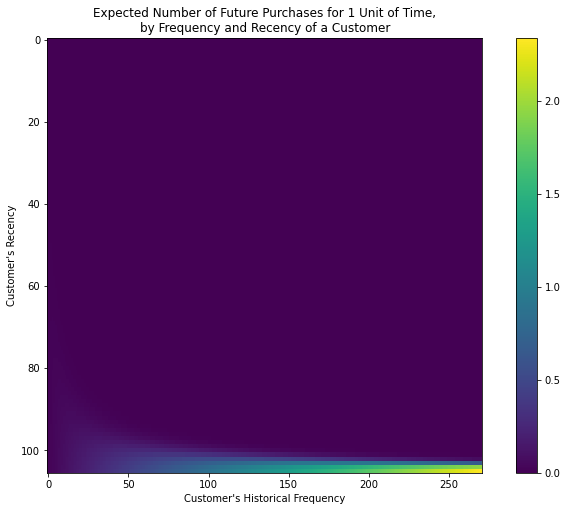

In [35]:
fig = plt.figure(figsize=(12,8))
p =plot_frequency_recency_matrix(bgf)
plt.savefig('p.png')

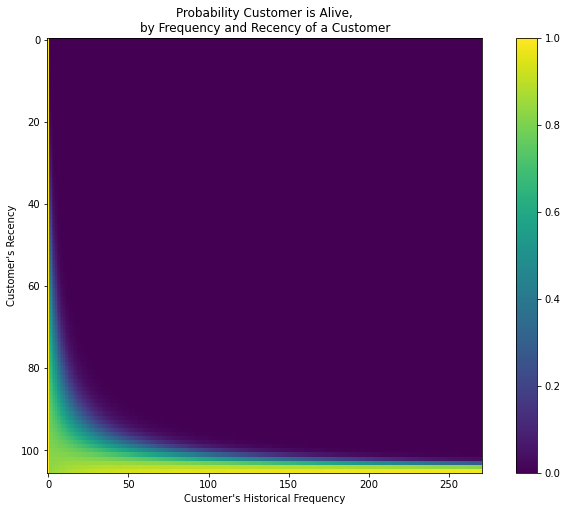

In [36]:
fig = plt.figure(figsize=(12,8))
a = plot_probability_alive_matrix(bgf)
a
plt.savefig('a.png')

In [37]:
summary_cal_holdout = calibration_and_holdout_data(fd, 'Customer ID', 'InvoiceDate',
                                        calibration_period_end='2010-11-09',
                                        observation_period_end='2011-01-01' )   
print(summary_cal_holdout.head())

             frequency_cal  recency_cal  T_cal  frequency_holdout  \
Customer ID                                                         
12346.0                6.0        196.0  330.0                0.0   
12347.0                0.0          0.0    9.0                1.0   
12348.0                0.0          0.0   43.0                0.0   
12349.0                2.0        182.0  194.0                0.0   
12353.0                0.0          0.0   13.0                0.0   

             duration_holdout  
Customer ID                    
12346.0                  53.0  
12347.0                  53.0  
12348.0                  53.0  
12349.0                  53.0  
12353.0                  53.0  


<AxesSubplot:title={'center':'Actual Purchases in Holdout Period vs Predicted Purchases'}, xlabel='Purchases in calibration period', ylabel='Average of Purchases in Holdout Period'>

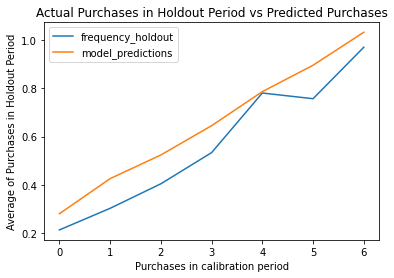

In [38]:
bgf.fit(summary_cal_holdout['frequency_cal'], summary_cal_holdout['recency_cal'], summary_cal_holdout['T_cal'])
plot_calibration_purchases_vs_holdout_purchases(bgf, summary_cal_holdout)

In [39]:
cltv_df["expected_purc_1_week"] = bgf.predict(1,cltv_df['frequency'],cltv_df['recency'],cltv_df['T'])
cltv_df["expected_purc_1_month"] = bgf.predict(4,cltv_df['frequency'],cltv_df['recency'],cltv_df['T'])
cltv_df.sort_values("expected_purc_1_week", ascending=False)
cltv_df.sort_values("expected_purc_1_month", ascending=False)

,recency,T,frequency,monetary,expected_purc_1_week,expected_purc_1_month
Customer ID,,,,,,
15329.0,51.428571,103.714286,16,108.592500,7.721015e-02,3.088111e-01
14030.0,53.142857,105.571429,16,361.593750,7.712280e-02,3.084620e-01
15694.0,52.285714,104.714286,16,258.928750,7.705021e-02,3.081716e-01
16858.0,51.142857,103.571429,16,255.358750,7.692939e-02,3.076881e-01
12839.0,52.142857,104.714286,16,271.513125,7.679260e-02,3.071412e-01
...,...,...,...,...,...,...
14156.0,52.285714,105.571429,138,1327.395290,3.414016e-18,1.365256e-17
15311.0,53.285714,105.571429,158,342.365380,1.408824e-20,5.633803e-20
12748.0,52.714286,105.142857,159,131.434151,7.292359e-21,2.916168e-20


# Gamma model

In [40]:
ggf = GammaGammaFitter(penalizer_coef=0.1)
ggf.fit(cltv_df['frequency'], cltv_df['monetary'])
fd

,Customer ID,Description,InvoiceDate,Invoice,Quantity,Price,Country,TotalPurchase
0,13085.0,15CM CHRISTMAS GLASS BALL 20 LIGHTS,2009-12-01 07:45:00,489434,12,6.95,United Kingdom,83.40
1,13085.0,PINK CHERRY LIGHTS,2009-12-01 07:45:00,489434,12,6.75,United Kingdom,81.00
2,13085.0,WHITE CHERRY LIGHTS,2009-12-01 07:45:00,489434,12,6.75,United Kingdom,81.00
3,13085.0,"RECORD FRAME 7"" SINGLE SIZE",2009-12-01 07:45:00,489434,48,2.10,United Kingdom,100.80
4,13085.0,STRAWBERRY CERAMIC TRINKET BOX,2009-12-01 07:45:00,489434,24,1.25,United Kingdom,30.00
...,...,...,...,...,...,...,...,...
525456,17530.0,FELTCRAFT DOLL ROSIE,2010-12-09 20:01:00,538171,2,2.95,United Kingdom,5.90
525457,17530.0,FELTCRAFT PRINCESS LOLA DOLL,2010-12-09 20:01:00,538171,1,3.75,United Kingdom,3.75
525458,17530.0,FELTCRAFT PRINCESS OLIVIA DOLL,2010-12-09 20:01:00,538171,1,3.75,United Kingdom,3.75
525459,17530.0,PINK FLORAL FELTCRAFT SHOULDER BAG,2010-12-09 20:01:00,538171,2,3.75,United Kingdom,7.50


In [41]:
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
def evaluate_clv(actual, predicted, bins):
    print(f"Average absolute error: {mean_absolute_error(actual, predicted)}")
    #Evaluate numeric
    plt.figure(figsize=(10, 7))
    plt.scatter(predicted, actual)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Predicted vs Actual')
    plt.show()
    
    #Evaluate Bins
    est = KBinsDiscretizer(n_bins=bins, encode='ordinal', strategy='kmeans')
    est.fit(np.array(actual).reshape(-1, 1))
    actual_bin = est.transform(np.array(actual).reshape(-1, 1)).ravel()
    predicted_bin = est.transform(np.array(predicted).reshape(-1, 1)).ravel()
    
    cm = confusion_matrix(actual_bin, predicted_bin, normalize='true')
    df_cm = pd.DataFrame(cm, index = range(1, bins+1),
                      columns = range(1, bins+1))
    plt.figure(figsize = (20,10))
    sns.heatmap(df_cm, annot=True)

    # fix for mpl bug that cuts off top/bottom of seaborn viz
    b, t = plt.ylim() # discover the values for bottom and top
    b += 0.5 # Add 0.5 to the bottom
    t -= 0.5 # Subtract 0.5 from the top
    plt.ylim(b, t) # update the ylim(bottom, top) values
    plt.show()
    print(f'F1 score: {f1_score(actual_bin, predicted_bin, average="macro")}')
    print('Samples in each bin: \n')
    print(pd.Series(actual_bin).value_counts())



In [42]:
summary_cal_holdout = calibration_and_holdout_data(fd, 'Customer ID', 'InvoiceDate',
                                        calibration_period_end='2010-11-09',
                                      observation_period_end='2011-01-01',
                                                   monetary_value_col = 'TotalPurchase') 
summary_cal_holdout
summary_cal_holdout = summary_cal_holdout[(summary_cal_holdout['monetary_value_cal']>0)]

    
ggf.fit(summary_cal_holdout['frequency_cal'],
        summary_cal_holdout['monetary_value_cal'])
summary_cal_holdout['monetary_pred'] = ggf.conditional_expected_average_profit(summary_cal_holdout['frequency_holdout'],
                                         summary_cal_holdout['monetary_value_holdout'])


fig_0 = px.scatter(summary_cal_holdout, x="monetary_value_holdout", y="monetary_pred", width=400, labels={
                     "monetary_value_holdout": "Actual",
                     "monetary_pred": "Predicted"
                 },
                title="GG model prediction")
fig_0.show()
# #evaluate_clv(summary_cal_holdout['monetary_value_holdout'], monetary_pred, bins=10)


In [43]:
fig = px.density_contour(summary_cal_holdout, x="monetary_value_holdout", y="monetary_pred",  marginal_x="histogram", marginal_y="histogram")
fig.show()

In [44]:
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from sklearn.svm import SVR

mesh_size = .02
margin = 0


# Create a mesh grid on which we will run our model
x_min, x_max = summary_cal_holdout.frequency_holdout.min() - margin, summary_cal_holdout.frequency_holdout.max() + margin
y_min, y_max = summary_cal_holdout.monetary_value_holdout.min() - margin, summary_cal_holdout.monetary_value_holdout.max() + margin
xrange = np.arange(x_min, x_max, mesh_size)
yrange = np.arange(y_min, y_max, mesh_size)
z_min, z_max = summary_cal_holdout.monetary_pred.min() - margin, summary_cal_holdout.monetary_pred.max() + margin
pred = np.arange(z_min, z_max, mesh_size)
xx, yy = np.meshgrid(xrange, yrange)


# Generate the plot
fig = px.scatter_3d(summary_cal_holdout, x='frequency_holdout', y='monetary_value_holdout', z='monetary_pred')
fig.update_traces(marker=dict(size=5))
fig.add_traces(go.Surface(x=xrange, y=yrange, z=pred, name='pred_surface'))
fig.show()

In [45]:
bgf = BetaGeoFitter(penalizer_coef=0.0)
bgf.fit(summary_cal_holdout['frequency_cal'], summary_cal_holdout['recency_cal'], summary_cal_holdout['T_cal'])

#Predict
summary_cal_holdout['predicted_bgf'] = bgf.predict(30, #how many days to predict
                        summary_cal_holdout['frequency_cal'], 
                        summary_cal_holdout['recency_cal'], 
                        summary_cal_holdout['T_cal'])
#evaluate_clv(summary_cal_holdout['frequency_holdout'], predicted_bgf, bins=10)


fig_5 = px.scatter(summary_cal_holdout, x="frequency_holdout", y="predicted_bgf", width=400, labels={
                     "frequency_holdout": "Actual",
                     "predicted_bgf": "Predicted"
                 },
                title="Beta Geo Fitter model prediction")
fig_5.show()




In [46]:
fig = px.density_contour(summary_cal_holdout, x="frequency_holdout", y="predicted_bgf",  marginal_x="histogram", marginal_y="histogram")
fig.show()

In [47]:
cltv_df["expected_average_profit"] = ggf.conditional_expected_average_profit(cltv_df['frequency'],cltv_df['monetary'])
cltv_df.sort_values("expected_average_profit", ascending=False)

,recency,T,frequency,monetary,expected_purc_1_week,expected_purc_1_month,expected_average_profit
Customer ID,,,,,,,
12357.0,0.000000,55.571429,2,6.039995e+03,0.021796,0.087180,10060.658251
14091.0,6.285714,99.857143,2,4.765040e+03,0.016242,0.064964,7937.162724
17450.0,10.000000,62.714286,8,5.762152e+03,0.060922,0.243670,6401.802158
13902.0,14.000000,104.571429,8,3.801408e+03,0.036066,0.144253,4223.441004
17308.0,8.428571,64.714286,2,2.255880e+03,0.020385,0.081536,3758.042648
...,...,...,...,...,...,...,...
12768.0,2.714286,64.428571,2,1.065814e-14,0.020410,0.081638,0.771929
13703.0,0.142857,59.428571,2,7.105427e-15,0.021167,0.084663,0.771929
14598.0,0.000000,81.428571,2,1.776357e-15,0.018158,0.072632,0.771929


In [48]:
x = cltv_df['expected_average_profit'].values.tolist()
hist_data = [x]
group_labels = ['expected_average_profit'] # name of the dataset

fig = ff.create_distplot(hist_data, group_labels)
fig.show()


In [49]:
cltv = ggf.customer_lifetime_value(bgf,
                                   cltv_df['frequency'],
                                   cltv_df['recency'],
                                   cltv_df['T'],
                                   cltv_df['monetary'],
                                   time=6, 
                                   freq="W",
                                   discount_rate=0.01)

In [50]:
cltv = cltv.reset_index()
cltv_final = cltv_df.merge(cltv, on="Customer ID", how="left")
cltv_final.sort_values(by="clv", ascending=False).head(10)

,Customer ID,recency,T,frequency,monetary,expected_purc_1_week,expected_purc_1_month,expected_average_profit,clv
2661,17450.0,10.000000,62.714286,8,5762.152500,0.060922,0.243670,6401.802158,8177.799169
4,12357.0,0.000000,55.571429,2,6039.995000,0.021796,0.087180,10060.658251,5487.770212
1793,15838.0,51.000000,103.571429,19,2108.071053,0.068563,0.274222,2200.686770,3882.267121
2921,17940.0,41.571429,105.285714,8,3122.055000,0.047373,0.189481,3468.689572,3614.151347
31,12415.0,21.714286,75.428571,7,2791.977143,0.050878,0.203498,3151.971091,3481.818553
881,14091.0,6.285714,99.857143,2,4765.040000,0.016242,0.064964,7937.162724,3221.887359
3061,18251.0,38.857143,102.571429,8,2745.517500,0.047970,0.191870,3050.361506,3204.438757
780,13902.0,14.000000,104.571429,8,3801.407500,0.036066,0.144253,4223.441004,3071.614475
2630,17381.0,25.571429,78.428571,12,1643.896667,0.072322,0.289262,1761.273587,2739.136448
880,14088.0,4.714286,60.285714,6,1997.421667,0.049146,0.196570,2304.537562,2417.776977


In [51]:
# 1 Month CLTV:
cltv_1 = ggf.customer_lifetime_value(bgf,
                                   cltv_df['frequency'],
                                   cltv_df['recency'],
                                   cltv_df['T'],
                                   cltv_df['monetary'],
                                   time=1,  # 1 month
                                   freq="W",  # frequency of T
                                   discount_rate=0.01)
cltv_1= cltv_1.reset_index()
cltv_1 = cltv_df.merge(cltv_1, on="Customer ID", how="left")
cltv_1.sort_values(by="clv", ascending=False).head(5)

,Customer ID,recency,T,frequency,monetary,expected_purc_1_week,expected_purc_1_month,expected_average_profit,clv
2661,17450.0,10.000000,62.714286,8,5762.152500,0.060922,0.243670,6401.802158,1399.311806
4,12357.0,0.000000,55.571429,2,6039.995000,0.021796,0.087180,10060.658251,939.920415
1793,15838.0,51.000000,103.571429,19,2108.071053,0.068563,0.274222,2200.686770,664.003011
2921,17940.0,41.571429,105.285714,8,3122.055000,0.047373,0.189481,3468.689572,618.244258
31,12415.0,21.714286,75.428571,7,2791.977143,0.050878,0.203498,3151.971091,595.746188


In [52]:
cltv_12 = ggf.customer_lifetime_value(bgf,
                                   cltv_df['frequency'],
                                   cltv_df['recency'],
                                   cltv_df['T'],
                                   cltv_df['monetary'],
                                   time=12, 
                                   freq="W",  
                                   discount_rate=0.01)
cltv_12 = cltv_12.reset_index()
cltv_12 = cltv_df.merge(cltv_12, on="Customer ID", how="left")
cltv_12.sort_values(by="clv", ascending=False).head(5)

,Customer ID,recency,T,frequency,monetary,expected_purc_1_week,expected_purc_1_month,expected_average_profit,clv
2661,17450.0,10.000000,62.714286,8,5762.152500,0.060922,0.243670,6401.802158,15854.778413
4,12357.0,0.000000,55.571429,2,6039.995000,0.021796,0.087180,10060.658251,10629.632697
1793,15838.0,51.000000,103.571429,19,2108.071053,0.068563,0.274222,2200.686770,7530.130032
2921,17940.0,41.571429,105.285714,8,3122.055000,0.047373,0.189481,3468.689572,7008.946877
31,12415.0,21.714286,75.428571,7,2791.977143,0.050878,0.203498,3151.971091,6750.747758


In [53]:

cltv_12_f = cltv_12.sort_values(by = 'clv', ascending=False).reset_index().head(50)


fig_miricle_0 = px.scatter(cltv_12_f, x='Customer ID', y="clv",  
        log_y= True, log_x= True, title= "Top 50 highest CLV customer predictions")
fig_miricle.update_layout({
'plot_bgcolor': 'rgba(0, 0, 0, 0)',
'paper_bgcolor': 'rgba(1, 0, 0, 0)',
})
fig_miricle_0.show()

In [54]:
x = cltv_12['clv'].values.tolist()

cumsum = np.cumsum(x)

trace = go.Scatter(x=[i for i in range(len(cumsum))], y=10*cumsum/np.linalg.norm(cumsum),
                     marker=dict(color='rgb(150, 25, 120)'))
layout = go.Layout(
    title="CDF of 12 month clv predictions"
)

fig = go.Figure(data=go.Data([trace]), layout=layout)
fig.show()


/opt/anaconda3/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:31: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


